## Initializing and imports

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


##IMPORTS

In [2]:
from __future__ import print_function, division
!pip install pytorch_lightning &> /dev/null


from torchvision.utils import draw_bounding_boxes
import os
import copy
import torch
import pandas as pd
from skimage import io, transform
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader, random_split, TensorDataset
from torchvision import transforms, utils
from  matplotlib.patches import Rectangle as rec
import numpy as np
import h5py
import cv2
import matplotlib.pyplot as plt
import torch
import torchvision
import torchvision.transforms as transforms
from PIL import Image
from scipy import ndimage
import torch.nn.functional as F

import torch.nn as nn
import pytorch_lightning as pl
import pytorch_lightning.loggers as pl_loggers
import pytorch_lightning.callbacks as pl_callbacks

from multiprocessing.connection import wait
import torch
from torch.nn import functional as F
from torchvision import transforms
from torch import nn, Tensor
import matplotlib.pyplot as plt
import torchvision
from scipy import stats as st


from torch.utils.data import Dataset, DataLoader
import h5py
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches


In [ ]:
# import torch
# from torch.nn import functional as F
# import numpy as np
# import torch
# from functools import partial
# import matplotlib.pyplot as plt
# import torchvision
# from scipy import stats as st
# from torchvision import transforms
# from torch import nn, Tensor



# def MultiApply(func, *args, **kwargs):
#     pfunc = partial(func, **kwargs) if kwargs else func
#     map_results = map(pfunc, *args)
  
#     return tuple(map(list, zip(*map_results)))

# # This function computes the IOU between two set of boxes
# def IOU(boxA, boxB):
#     ##################################
#     #TODO compute the IOU between the boxA, boxB boxes
#     #Reference: used gpt to corrcet and debug shapes
#     #Reference: https://stackoverflow.com/questions/509211/how-slicing-in-python-works 
#     convboxA = torch.zeros_like(boxA)
#     convboxA[:, 0] = torch.sub(boxA[:, 0], (boxA[:, 2] / 2))
#     convboxA[:, 2] = torch.add(boxA[:, 0], boxA[:, 2] / 2)
#     convboxA[:, 1] = torch.sub(boxA[:, 1], boxA[:, 3] / 2)
#     convboxA[:, 3] = torch.add(boxA[:, 1], boxA[:, 3] / 2)

#     final_iou = torchvision.ops.box_iou(convboxA, boxB)
#     ##################################
#     return final_iou




# # This function flattens the output of the network and the corresponding anchors 
# # in the sense that it concatenates  the outputs and the anchors from all the grid cells
# # from all the images into 2D matrices
# # Each row of the 2D matrices corresponds to a specific anchor/grid cell
# # Input:
# #       out_r: (bz,4,grid_size[0],grid_size[1])
# #       out_c: (bz,1,grid_size[0],grid_size[1])
# #       anchors: (grid_size[0],grid_size[1],4)
# # Output:
# #       flatten_regr: (bz*grid_size[0]*grid_size[1],4)
# #       flatten_clas: (bz*grid_size[0]*grid_size[1])
# #       flatten_anchors: (bz*grid_size[0]*grid_size[1],4)
# def output_flattening(out_r,out_c,anchors):
#     #######################################
#     # TODO flatten the output tensors and anchors
#     #######################################

    
#     batch_size_squeeze = out_r.squeeze(0)
#     batch_size = batch_size_squeeze.shape[0]
#     #flattening classification outputs
#     flatten_clas_squeeze = out_c.squeeze(1)
#     flatten_clas = flatten_clas_squeeze.reshape(-1)
#     #flatten regression outputs
#     flatten_regr_per = out_r.squeeze(0).permute(0,2,3,1)
#     flatten_regr = flatten_regr_per.reshape(-1,4)
#     # flattening anchors
#     flatten_anchors_reshape = anchors.reshape(-1,4)
#     flatten_anchors = flatten_anchors_reshape.repeat(batch_size,1)

#     return flatten_regr, flatten_clas, flatten_anchors




# # This function decodes the output that is given in the encoded format (defined in the handout)
# # into box coordinates where it returns the upper left and lower right corner of the proposed box
# # Input:
# #       flatten_out: (total_number_of_anchors*bz,4)
# #       flatten_anchors: (total_number_of_anchors*bz,4)
# # Output:
# #       box: (total_number_of_anchors*bz,4)
# def output_decoding(flatten_out,flatten_anchors, device='cpu'):
#     #Reference: https://stackoverflow.com/questions/509211/how-slicing-in-python-works 
#     #######################################
#     # TODO decode the output
#     #######################################

#     # Apply transformations to flattened outputs to decode them into box coordinates
#     widths = torch.exp(flatten_out[:, 2]) * flatten_anchors[:, 2]
#     heights = torch.exp(flatten_out[:, 3]) * flatten_anchors[:, 3]
#     ctr_x = flatten_out[:, 0] * flatten_anchors[:, 2] + flatten_anchors[:, 0]
#     ctr_y = flatten_out[:, 1] * flatten_anchors[:, 3] + flatten_anchors[:, 1]

#     # Calculate the top left and bottom right corners of the bounding boxes
#     top_left_x = ctr_x - widths / 2
#     top_left_y = ctr_y - heights / 2
#     bottom_right_x = ctr_x + widths / 2
#     bottom_right_y = ctr_y + heights / 2

#     # Combine the coordinates into the final bounding box format
#     # The device context is applied to the tensor creation step to ensure the output is on the correct device
#     boxes = torch.cat(
#         (top_left_x.unsqueeze(1), top_left_y.unsqueeze(1),
#          bottom_right_x.unsqueeze(1), bottom_right_y.unsqueeze(1)),
#         dim=1
#     ).to(device)

#     return boxes

## CUDA CHECK

In [3]:
use_cuda = torch.cuda.is_available()
device = torch.device("cuda:0" if use_cuda else "cpu")
seed = 17
torch.manual_seed(seed);

In [4]:
%cd /content/drive/MyDrive/cis6800/FASTER_RCNN/

/content/drive/.shortcut-targets-by-id/1J4Q5beS0Oewqny80EQ_nmxWo4SI1XQRU/cis6800/FASTER_RCNN


In [ ]:
#Standard libraries
import os
import copy
import pandas as pd
from skimage import io, transform
from scipy import stats as st
from scipy import ndimage
from PIL import Image
import numpy as np
import h5py
import cv2

# PyTorch related
import torch
from torch import nn, Tensor
from torch.utils.data import Dataset, DataLoader, random_split, TensorDataset
from torch.nn import functional as F
import torchvision
from torchvision import transforms, utils
from torchvision.utils import draw_bounding_boxes

# PyTorch Lightning related
import pytorch_lightning as pl
from pytorch_lightning.callbacks import ModelCheckpoint
import pytorch_lightning.loggers as pl_loggers
import pytorch_lightning.callbacks as pl_callbacks

# Local modules
from utils import *
from dataset import *

# Visualization
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle as rec

# Multiprocessing
from multiprocessing.connection import wait

# CUDA for PyTorch
use_cuda = torch.cuda.is_available()
device = torch.device("cuda:0" if use_cuda else "cpu")
seed = 17
torch.manual_seed(seed);

import numpy as np
import matplotlib.pyplot as plt
from scipy import stats as st


class RPNHead(pl.LightningModule):

    def __init__(self,  anchors_param=dict(ratio=0.8,scale= 256, grid_size=(50, 68), stride=16)):
        # Initialize the backbone, intermediate layer clasifier and regressor heads of the RPN
        super(RPNHead,self).__init__()
        # setattr(self, device, anchors_param)
        # self.device = device
        self.train_losses = []
        self.val_losses   = []
        self.accumulated_val_losses = []
        self.accumulated_val_class_losses = []
        self.accumulated_val_regression_losses = []
        self.accumulated_train_losses = []
        self.accumulated_train_class_losses = []
        self.accumulated_train_regression_losses = []

        self.sy     = 800
        self.sx     = 1088
        # TODO Define Backbone
        self.backbone = nn.Sequential(nn.Conv2d(3, 16,    kernel_size=5, stride=1, padding="same"),
                                      nn.BatchNorm2d(16),
                                      nn.ReLU(),
                                      nn.MaxPool2d(kernel_size=2, stride=2, padding=0),
                                      nn.Conv2d(16, 32,   kernel_size=5, stride=1, padding="same"),
                                      nn.BatchNorm2d(32),
                                      nn.ReLU(),
                                      nn.MaxPool2d(kernel_size=2, stride=2, padding=0),
                                      nn.Conv2d(32, 64,   kernel_size=5, stride=1, padding="same"),
                                      nn.BatchNorm2d(64),
                                      nn.ReLU(),
                                      nn.MaxPool2d(kernel_size=2, stride=2, padding=0),
                                      nn.Conv2d(64, 128,  kernel_size=5, stride=1, padding="same"),
                                      nn.BatchNorm2d(128),
                                      nn.ReLU(),
                                      nn.MaxPool2d(kernel_size=2, stride=2, padding=0),
                                      nn.Conv2d(128, 256, kernel_size=5, stride=1, padding="same"),
                                      nn.BatchNorm2d(256),
                                      nn.ReLU())

        # TODO  Define Intermediate Layer
        self.intermediate_layer = nn.Sequential(nn.Conv2d(256, 256, 3,   stride=1, padding="same"), 
                                                nn.BatchNorm2d(256), 
                                                nn.ReLU())

        # TODO  Define Proposal Classifier Head
        self.proposal_classifier_head = nn.Sequential(nn.Conv2d(256,1,1, stride=1, padding="same"),
                                                      nn.Sigmoid())

        # TODO Define Proposal Regressor Head
        self.proposal_regressor_head = nn.Sequential(nn.Conv2d(256,4,1, stride=1, padding="same"))

        #  find anchors
        self.anchors_param=anchors_param
        self.anchors=self.create_anchors(self.anchors_param['ratio'],self.anchors_param['scale'],self.anchors_param['grid_size'],self.anchors_param['stride'])
        self.ground_dict={}





    # Forward  the input through the backbone the intermediate layer and the RPN heads
    # Input:
    #       X: (bz,3,image_size[0],image_size[1])}
    # Ouput:
    #       logits: (bz,1,grid_size[0],grid_size[1])}
    #       bbox_regs: (bz,4, grid_size[0],grid_size[1])}
    def forward(self, X):

        #TODO forward through the Backbone
        x = self.backbone(X)


        #TODO forward through the Intermediate layer
        intermediate_out = self.intermediate_layer(x)


        #TODO forward through the Classifier Head
        logits = self.proposal_classifier_head(intermediate_out)


        #TODO forward through the Regressor Head
        bbox_regs  = self.proposal_regressor_head(intermediate_out)


        assert logits.shape[1:4]==(1,self.anchors_param['grid_size'][0],self.anchors_param['grid_size'][1])
        assert bbox_regs.shape[1:4]==(4,self.anchors_param['grid_size'][0],self.anchors_param['grid_size'][1])

        return logits, bbox_regs






    # Compute the loss of the regressor
    # Input:
    #       pos_target_coord: (positive_on_mini_batch,4) (ground truth of the regressor for sampled anchors with positive gt labels)
    #       pos_out_r: (positive_on_mini_batch,4)        (output of the regressor for sampled anchors with positive gt labels)
    def loss_reg(self,pos_target_coord,pos_out_r, non_zero = False):
            #torch.nn.SmoothL1Loss()
            # TODO compute regressor's loss
            loss        = torch.nn.SmoothL1Loss()
            if non_zero == False:
                reg_loss = 0
                for i in range(4):
                    reg_loss += loss(pos_target_coord[i], pos_out_r[i])
                reg_loss = torch.tensor(reg_loss)
            else:
                reg_loss = torch.tensor(0)

            return reg_loss



    # Compute the total loss
    # Input:
    #       clas_out: (bz,1,grid_size[0],grid_size[1])
    #       regr_out: (bz,4,grid_size[0],grid_size[1])
    #       targ_clas:(bz,1,grid_size[0],grid_size[1])
    #       targ_regr:(bz,4,grid_size[0],grid_size[1])
    #       l: lambda constant to weight between the two losses
    #       effective_batch: the number of anchors in the effective batch (M in the handout)
    def compute_loss(self, clas_out, regr_out, targ_clas, targ_regr, l=1, effective_batch=50):
            #############################
            # TODO compute the total loss
            #############################

            
            positives_indexes   = torch.where(targ_clas == 1)
            negative_indexes    = torch.where(targ_clas == 0)

            p_count = min(positives_indexes[0].size(0), effective_batch // 2)
            n_count = effective_batch - p_count

            # Shuffle indices and select based on effective batch size
            shuffled_pos_indices = torch.randperm(positives_indexes[0].size(0))[:p_count]
            shuffled_neg_indices = torch.randperm(negative_indexes[0].size(0))[:n_count]

            # Extract final indices for positives and negatives
            final_positives_indexes = tuple(positives_indexes[dim][shuffled_pos_indices] for dim in range(4))
            final_negatives_indexes = tuple(negative_indexes[dim][shuffled_neg_indices] for dim in range(4))

            # Assign the indices for positives and negatives
            final_pos_indexes = final_positives_indexes
            final_neg_indexes = final_negatives_indexes

            # Classification loss for positive and negative samples using the original variable names
            pos_gt = targ_clas[final_pos_indexes]  # Ground truth for positive samples
            pos_preds = clas_out[final_pos_indexes]  # Predictions for positive samples
            loss1 = self.loss_class(pos_preds, pos_gt)  # Loss for positive samples

            neg_gt = targ_clas[final_neg_indexes]  # Ground truth for negative samples
            neg_preds = clas_out[final_neg_indexes]  # Predictions for negative samples
            loss2 = self.loss_class(neg_preds, neg_gt)  # Loss for negative samples

                        
            loss_c = loss1 + loss2

            targ_class = targ_clas.view(-1)
            clas_out = clas_out.view(-1)

            # Find the indices of the positive class
            pos_indices = (targ_class == 1).nonzero(as_tuple=False).view(-1)
            eff = effective_batch 

            # Calculate the number of positives needed based on the effective batch size
            num_positives = min(len(pos_indices), eff // 2)

            # Shuffle the indices and select the desired amount for positives
            selected_indices = torch.randperm(len(pos_indices))[:num_positives]
            pos_class = pos_indices[selected_indices]

            non_zero = (pos_class.numel() == 0)

            # Permute and reshape the target and prediction tensors for regression
            reshaped_targ_regr = targ_regr.permute(1, 0, 2, 3).contiguous().view(4, -1)
            reshaped_regr_pred = regr_out.permute(1, 0, 2, 3).contiguous().view(4, -1)

            # Select the regression values for the positive classes
            selected_targ_regr = reshaped_targ_regr[:, pos_class.view(-1)]
            selected_regr_pred = reshaped_regr_pred[:, pos_class.view(-1)]

            # Compute the regression loss (check, this formulation works !!1)
            loss_r = self.loss_reg(selected_targ_regr, selected_regr_pred, non_zero)


            loss = loss_c + l*loss_r

            return loss, loss_c, loss_r







    # Post process the output for one image
    # Input:
    #      mat_clas: (1,grid_size[0],grid_size[1])}  (scores of the output boxes)
    #      mat_coord: (4,grid_size[0],grid_size[1])} (encoded coordinates of the output boxes)
    # Output:
    #       nms_clas: (Post_NMS_boxes)
    #       nms_prebox: (Post_NMS_boxes,4) (decoded coordinates of the boxes that the NMS kept)

    def postprocessImg(self, mat_clas, mat_coord, IOU_thresh, keep_num_preNMS, keep_num_postNMS):
        #Reference: used gpt to corrcet and debug shapes
    #Reference: https://pytorch.org/tutorials/beginner/ptcheat.html
    #Reference: https://pytorch.org/docs/stable/generated/torch.sort.html
        # TODO postprocess a single image
        anchors = self.get_anchors()
        mat_coord = mat_coord.permute(1, 2, 0)

        # Decode the coordinates
        x_center = (mat_coord[:, :, 0] * anchors[:, :, 2]) + anchors[:, :, 0]
        y_center = (mat_coord[:, :, 1] * anchors[:, :, 3]) + anchors[:, :, 1]
        width = anchors[:, :, 2] * torch.exp(mat_coord[:, :, 2])
        height = anchors[:, :, 3] * torch.exp(mat_coord[:, :, 3])

        # Convert to x1, y1, x2, y2 format
        x1 = x_center - (width / 2.0)
        y1 = y_center - (height / 2.0)
        x2 = x_center + (width / 2.0)
        y2 = y_center + (height / 2.0)

        # Stack and reshape the boxes
        decoded_boxes = torch.stack((x1, y1, x2, y2), dim=2).view(-1, 4)

        # Filter valid boxes
        valid_idx = torch.where(
            (decoded_boxes[:, 0] >= 0) &
            (decoded_boxes[:, 1] >= 0) &
            (decoded_boxes[:, 2] < 1088) &
            (decoded_boxes[:, 3] < 800)
        )[0]
        valid_boxes = decoded_boxes[valid_idx]

        # Flatten and sort the classification scores
        mat_clas_flat = mat_clas.flatten()
        sorted_indices = torch.sort(mat_clas_flat[valid_idx], descending=True)
        top_scores = sorted_indices[0][:keep_num_preNMS]
        top_boxes_indices = sorted_indices[1][:keep_num_preNMS]
        pre_nms_matrix = valid_boxes[top_boxes_indices]

        # Apply NMS
        nms_clas, nms_prebox = self.NMS(top_scores, pre_nms_matrix, thresh=IOU_thresh)

        # Keep only the top results after NMS
        nms_clas = nms_clas[:keep_num_postNMS]
        nms_prebox = nms_prebox[:keep_num_postNMS]

        return top_scores, pre_nms_matrix, nms_clas, nms_prebox



    # Input:
    #       clas: (top_k_boxes) (scores of the top k boxes)
    #       prebox: (top_k_boxes,4) (coordinate of the top k boxes)
    # Output:
    #       nms_clas: (Post_NMS_boxes)
    #       nms_prebox: (Post_NMS_boxes,4)

    def NMS(self, clas, prebox, thresh):
        # TODO perform NMS
        prebox_cp = prebox.clone()
        clas_cp = clas.clone()

        # Compute the pairwise IoU between the boxes
        pairwise_iou = torchvision.ops.box_iou(prebox_cp, prebox_cp)

        # Initialize a set to keep track of indices that we need to delete
        rows_to_delete = set()

        # Iterate through each box and compare with the others
        for i in range(len(prebox_cp)):
            if i not in rows_to_delete:
                for j in range(i + 1, len(prebox_cp)):
                    if pairwise_iou[i, j] > thresh:
                        rows_to_delete.add(j)

        # Delete the rows marked for deletion in both `prebox_cp` and `clas_cp`
        # Using `torch.index_select` for a more efficient and tensor-friendly operation (check this)
        rows_to_keep = torch.tensor(list(set(range(len(prebox_cp))) - rows_to_delete))
        prebox_cp = torch.index_select(prebox_cp, 0, rows_to_keep)
        clas_cp = torch.index_select(clas_cp, 0, rows_to_keep)

        return clas_cp, prebox_cp




def plot_bounding_box(image, labels):
    # Create a figure and a single subplot
    fig, ax = plt.subplots(figsize=(30, 10))
    
    # Display the image
    ax.imshow(image)
    
    # Add rectangles for each label
    for label in labels:
        # Define a rectangle patch using label coordinates
        rectangle_s = patches.Rectangle((label[0], label[1]), label[2] - label[0], label[3] - label[1],
                                 linewidth=2, edgecolor='r', facecolor='none')
        
        # Add the rectangle to the Axes
        ax.add_patch(rectangle_s)
    
    # Display the plot
    plt.show()

## FILE PATHS

In [5]:
# file path and make a list
imgs_path   = '/content/drive/MyDrive/cis6800/FASTER_RCNN/hw3_mycocodata_img_comp_zlib.h5'
masks_path  = '/content/drive/MyDrive/cis6800/FASTER_RCNN/hw3_mycocodata_mask_comp_zlib.h5'
labels_path = '/content/drive/MyDrive/cis6800/FASTER_RCNN/hw3_mycocodata_labels_comp_zlib.npy'
bboxes_path = '/content/drive/MyDrive/cis6800/FASTER_RCNN/hw3_mycocodata_bboxes_comp_zlib.npy'
paths = [imgs_path, masks_path, labels_path, bboxes_path]

## DATASET IMPORTS


In [6]:
from dataset import *
from utils import *
from rpn import *

## DATASET BUILD

In [7]:
dataset = BuildDataset(paths)

# dataloader building
total_size = len(dataset)
size_train = int(total_size * 0.8)
size_test = total_size - size_train

# splitting
train_dataset, test_dataset = torch.utils.data.random_split(dataset, [size_train, size_test])
rpn_net = RPNHead()
# batch size
batch_size = 4

## BUILD AND LOAD

In [8]:
build_loader_train = BuildDataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
train_loader = build_loader_train.loader()
build_loader_test = BuildDataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=0)
test_loader = build_loader_test.loader()

## Training the Model

In [ ]:
# Reference: gpt for getting the correct shape, training commands, ddebugging and handout instructiuons
#Reference: https://www.interviewkickstart.com/learn/the-append-function-in-python

from pytorch_lightning import Trainer
from pytorch_lightning.callbacks import ModelCheckpoint
from pytorch_lightning.loggers import TensorBoardLogger

# Directory to save model checkpoints
checkpoint_dir = "./training_data_nm"

# Callback to save the top 3 model checkpoints based on the lowest validation loss
validation_chkpoint_cb = ModelCheckpoint(
    monitor="val_loss",
    dirpath=checkpoint_dir,
    filename="val_loss-{epoch:02d}-{val_loss:.2f}",
    save_top_k=3,
    mode="min",
)

# Callback to save the top 3 model checkpoints based on the lowest training loss
training_chkpoint_cb = ModelCheckpoint(
    monitor="train_loss",
    dirpath=checkpoint_dir,
    filename="train_loss-{epoch:02d}-{train_loss:.2f}",
    save_top_k=3,
    mode="min",
)

# Setup for TensorBoard logging
tb_logger = pl_loggers.TensorBoardLogger("logs/")

# Initialize the Trainer with the specified callbacks and logger
trainer = pl.Trainer(logger=tb_logger, max_epochs=40,callbacks=[validation_chkpoint_cb,training_chkpoint_cb])
resume_from_checkpoint=False

# Fit the model to the data
trainer.fit(rpn_net, train_loader, test_loader)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name                     | Type       | Params
--------------------------------------------------------
0 | backbone                 | Sequential | 1.1 M 
1 | intermediate_layer       | Sequential | 590 K 
2 | proposal_classifier_head | Sequential | 257   
3 | proposal_regressor_head  | Sequential | 1.0 K 
--------------------------------------------------------
1.7 M     Trainable params
0         Non-trainable params
1.7 M     Total params
6.730     Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/connectors/data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=1` in the `DataLoader` to improve performance.
/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  w

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=40` reached.


In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs/lightning_logs/

<IPython.core.display.Javascript object>

## Question 2: Save losses and Histograms of scales and aspect ratios, along with explanation about the choice of scale and aspect ratio in your implementation. (Section 4.1)

mode_scale.mode: 792.8099992678804, type: <class 'numpy.float64'>
mode_ar.mode: 1.0006253908692935, type: <class 'numpy.float64'>


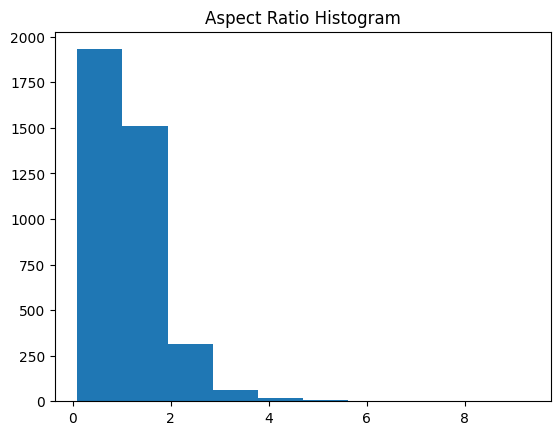

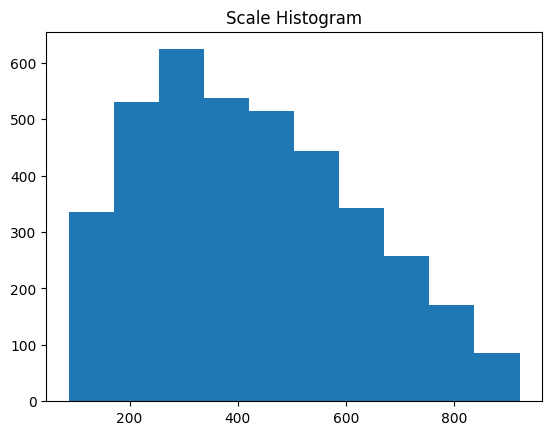

([425.4656465848386, 1.1554366027804388],
 [404.3293045408205, 1.0111759884745717],
 [792.8099992678804, 1.0006253908692935])

In [12]:
torch.save(rpn_net.state_dict(), 'rpn_l.pth')
np.save('tlosses_rpnl.npy', rpn_net.train_losses)
np.save('vlosses_rpnl.npy', rpn_net.val_losses)
def histogram(bboxes_path):
    #reference: https://www.geeksforgeeks.org/plotting-histogram-in-python-using-matplotlib/ , gpt for fine tuning

    bboxes = np.load(bboxes_path, allow_pickle=True)

    ar_list = []
    scale_list = []
    for each in bboxes:
        for each_box in each:
            x1 = each_box[0] * (800/300)
            x2 = each_box[2] * (800/300)
            y1 = (each_box[1] * (1066/400)) + 11
            y2 = (each_box[3] * (1066/400)) + 11

            ar = np.abs((x2 - x1) / (y2 - y1))
            ar_list.append(ar)
            scale = np.sqrt((x2-x1) * (y2-y1))
            scale_list.append(scale)

    mean_vals = [np.mean(scale_list), np.mean(ar_list)]
    medn_vals = [np.median(scale_list), np.median(ar_list)]

    mode_scale = st.mode(scale_list)
    mode_ar = st.mode(ar_list)

    # Check the type and length of mode_scale.mode and mode_ar.mode
    print(f"mode_scale.mode: {mode_scale.mode}, type: {type(mode_scale.mode)}")
    print(f"mode_ar.mode: {mode_ar.mode}, type: {type(mode_ar.mode)}")

    # We assume that mode_scale.mode and mode_ar.mode are NumPy arrays
    mode_vals = [mode_scale.mode, mode_ar.mode]

    plt.hist(ar_list)
    plt.title('Aspect Ratio Histogram')
    plt.figure()
    plt.hist(scale_list)
    plt.title('Scale Histogram')
    plt.show()

    return mean_vals, medn_vals, mode_vals

histogram(bboxes_path)

We chose the mode scale as 280 and aspect ratio close to 1. The scale and aspect ratio parameters in our object detection implementation are chosen to reflect the predominant shapes and sizes of the objects in our dataset. Our analysis indicated a median scale suggesting a prevalence of smaller objects and an aspect ratio close to one, pointing to a majority of objects being nearly square. These insights led to the tuning of our detection model to efficiently identify smaller, square-like objects, while also accounting for the presence of larger and varied-shaped objects, ensuring a versatile and accurate detection across our dataset.

## Question 1& 3: Images that show the positive anchors and the corresponding ground truth boxes, similar to figure (4)[ at least 4]. (Section 4.2)

/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


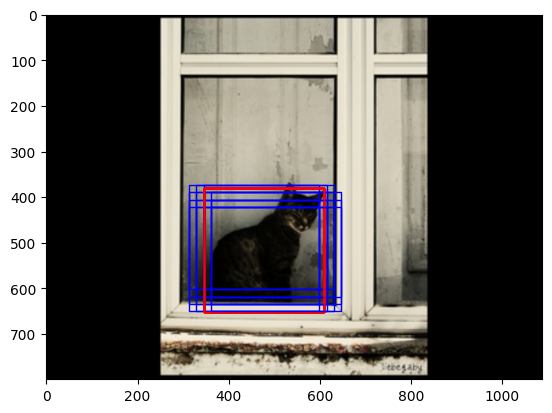

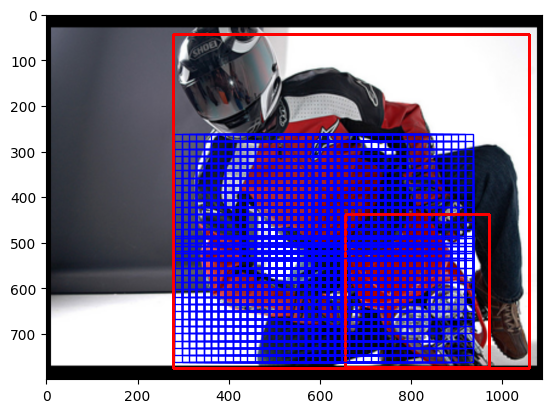

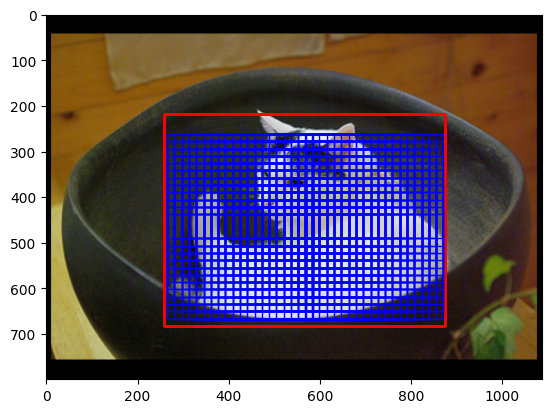

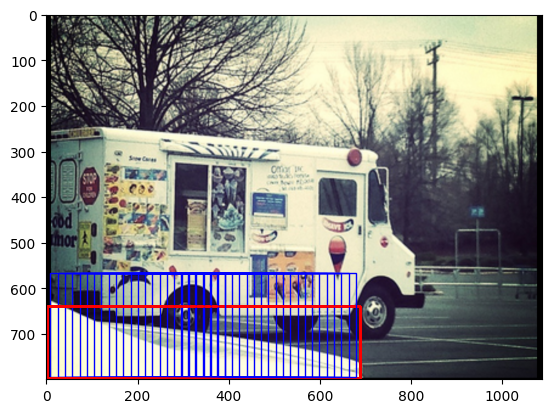

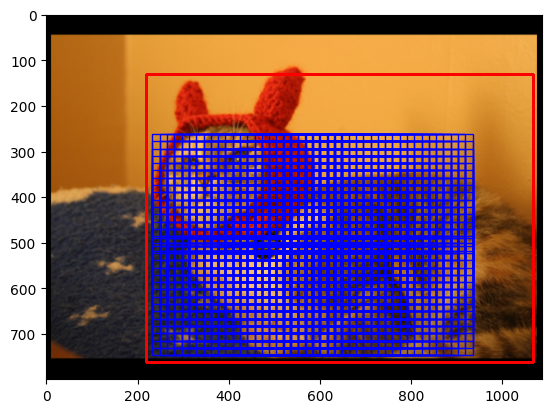

...

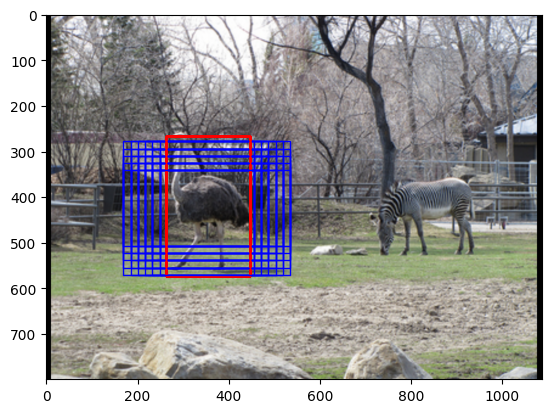

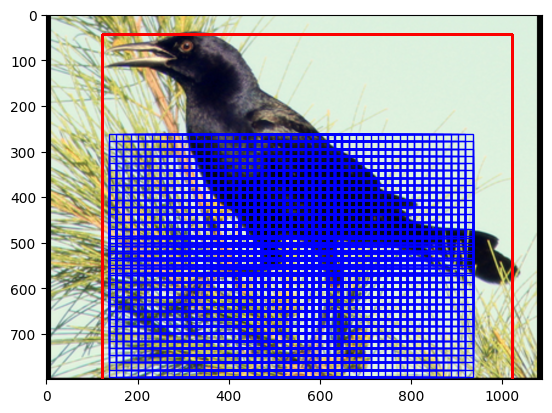

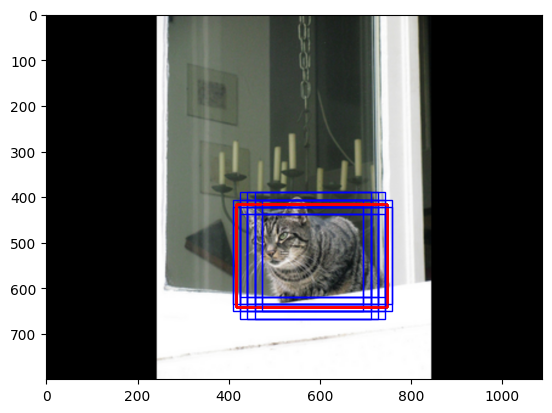

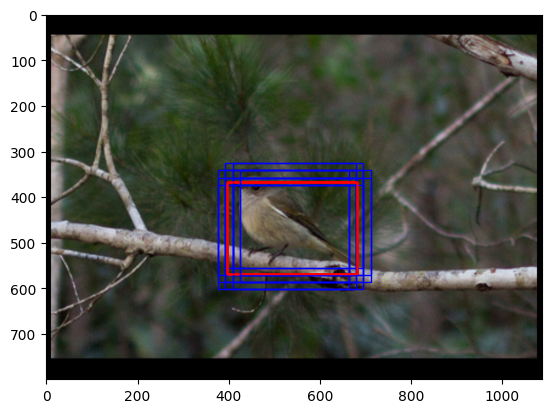

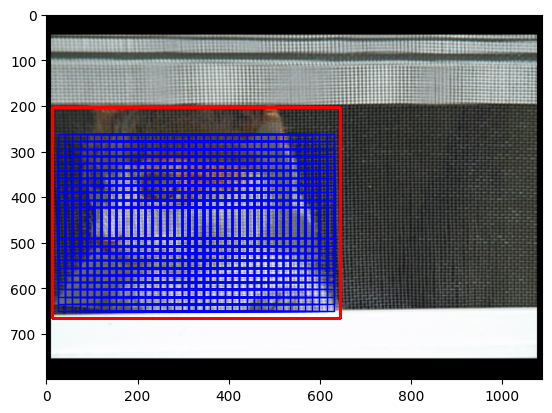

In [13]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from torchvision import transforms


batch_size = 1
train_build_loader = BuildDataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
train_loader = train_build_loader.loader()

for i, batch in enumerate(train_loader):
    images = torch.stack(batch['images'])
    indexes = batch['index']
    boxes = batch['bbox']

    gt, ground_coord = rpn_net.create_batch_truth(boxes, indexes, (800,1088))
    coord_flatten, gt_flatten, anchors_flatten = output_flattening(ground_coord.unsqueeze(0), gt.unsqueeze(0), rpn_net.anchors)
    decoded_coord = output_decoding(coord_flatten, anchors_flatten)

    # Normalize the images
    normalized_images = transforms.functional.normalize(images, [-0.485/0.229, -0.456/0.224, -0.406/0.225], [1/0.229, 1/0.224, 1/0.225])

    # Visualization setup
    fig, ax = plt.subplots(1)
    ax.imshow(normalized_images[0].permute(1,2,0))

    positive_indices = (gt_flatten == 1).nonzero(as_tuple=False)
    for idx in positive_indices:
        coord = decoded_coord[idx].view(-1)
        anchor = anchors_flatten[idx].view(-1)
        ax.add_patch(patches.Rectangle((coord[0], coord[1]), coord[2] - coord[0], coord[3] - coord[1], fill=False, color='r'))
        ax.add_patch(patches.Rectangle((anchor[0] - anchor[2]/2, anchor[1] - anchor[3]/2), anchor[2], anchor[3], fill=False, color='b'))

    plt.show()

    # Only show a certain number of images
    if i >= 10:
        break


## Question 4: Training and Validation curves that show the total loss, the loss of the classifier and the loss of the regressor. (Section 4.6)

In [ ]:
import matplotlib.pyplot as plt

# reference: used gpto to generate the plot code for plotting the loss curves

def loss_curves():
    # Initialize lists for training loss components
    train_total_loss = []
    train_classifier_loss = []
    train_regressor_loss = []

    # Extract training losses from the network's history and append to lists
    for train_loss in rpn_net.train_losses:
        train_total_loss.append(train_loss[0])
        train_classifier_loss.append(train_loss[1])
        train_regressor_loss.append(train_loss[2])

    # Plot training losses
    plt.plot(train_total_loss)
    plt.title("Train Loss")
    plt.show()

    plt.plot(train_classifier_loss)
    plt.title("Train Classifier Loss")
    plt.show()

    plt.plot(train_regressor_loss)
    plt.title("Train Regressor Loss")
    plt.show()

    # Initialize lists for validation loss components
    val_total_loss = []
    val_classifier_loss = []
    val_regressor_loss = []

    # Extract validation losses from the network's history and append to lists
    for val_loss in rpn_net.val_losses:
        val_total_loss.append(val_loss[0])
        val_classifier_loss.append(val_loss[1])
        val_regressor_loss.append(val_loss[2])

    # Plot validation losses
    plt.plot(val_total_loss)
    plt.title("Test Loss")
    plt.show()

    plt.plot(val_classifier_loss)
    plt.title("Test Classifier Loss")
    plt.show()

    plt.plot(val_regressor_loss)
    plt.title("Test Regressor Loss")
    plt.show()

## Calling loss curves function

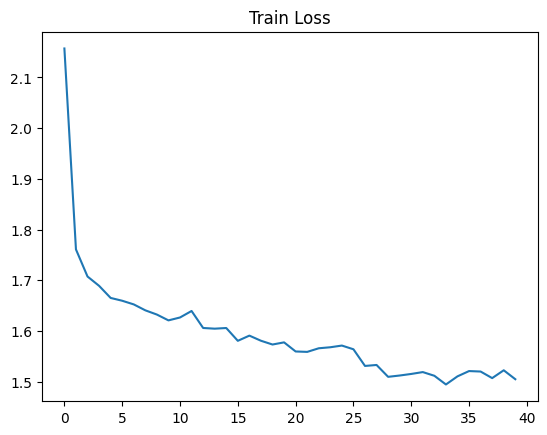

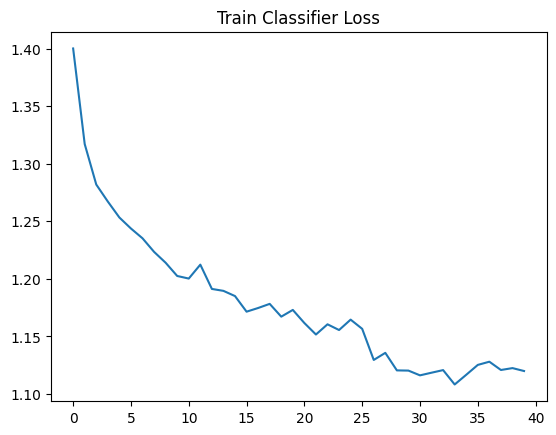

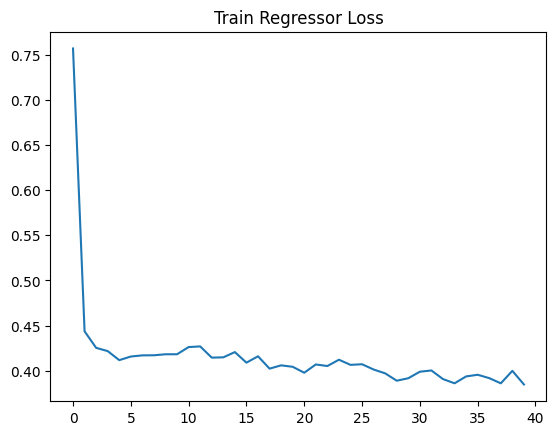

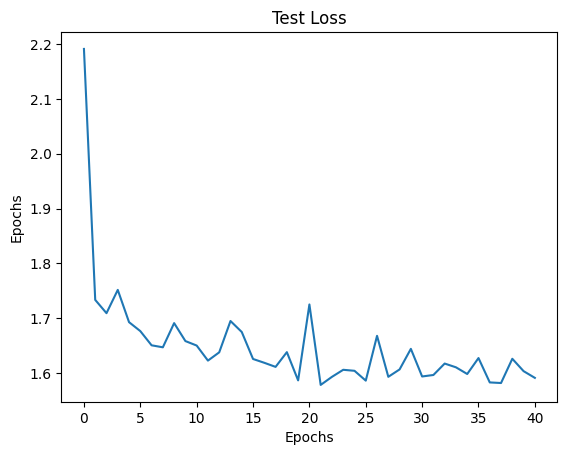

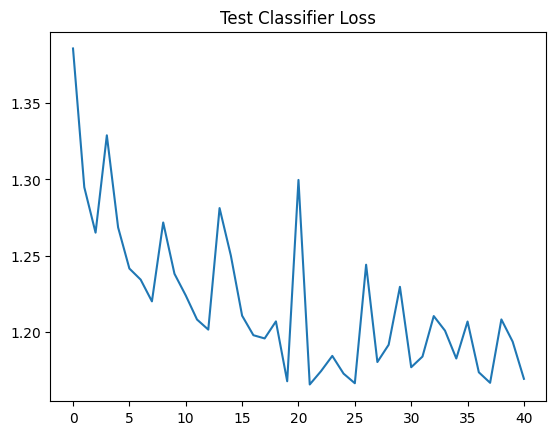

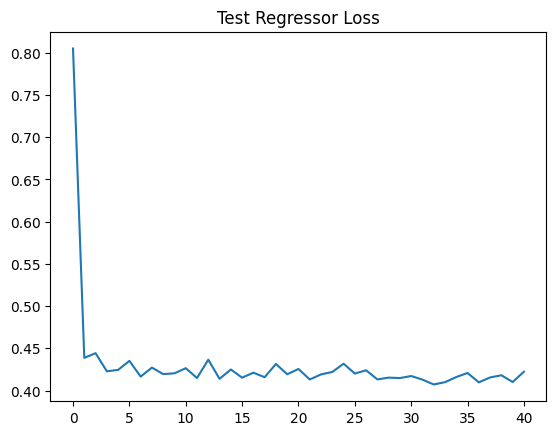

In [ ]:
loss_curves()

## Question 5 Report of the point-wise accuracy of the proposal classifier. Plots of the top 20 proposals for some images of the test set. [at least 4]. (Section 4.6)

In [14]:
rpn_net.to(device)

# Reference: gpt for getting the correct shape, and handout instructiuons

for i, batch in enumerate(test_loader, 0):
    images = batch['images']
    images = torch.stack(images[:]).to(device)  # Move images to the same device as the model
    indexes = batch['index']
    boxes = batch['bbox']

    # Create ground truth
    gt, ground_coord = rpn_net.create_batch_truth(boxes, indexes, (800, 1088))

    # Get predictions
    logits, bbox_regs = rpn_net(images)  # Images are already on the device

    # Compute the indexes where ground truth is 1 (positive anchors)
    indexes = torch.where(gt == 1)

    # Compute the number of correct predictions by comparing with ground truth
    correct_preds = logits[indexes].ge(0.5).float()  # ge is 'greater or equal', threshold is 0.5 for binary classification
    num_correct = correct_preds.sum()

    # Calculate accuracy
    accuracy = num_correct / indexes[0].numel()

    # Print the accuracy for each batch
    print(f'Batch {i + 1} Accuracy: {accuracy.item()}')

    # Break after the third batch (i == 2 for zero-based indexing)
    if i == 2:
        break


Batch 1 Accuracy: 0.6646971702575684
Batch 2 Accuracy: 0.663636326789856
Batch 3 Accuracy: 0.7009131908416748


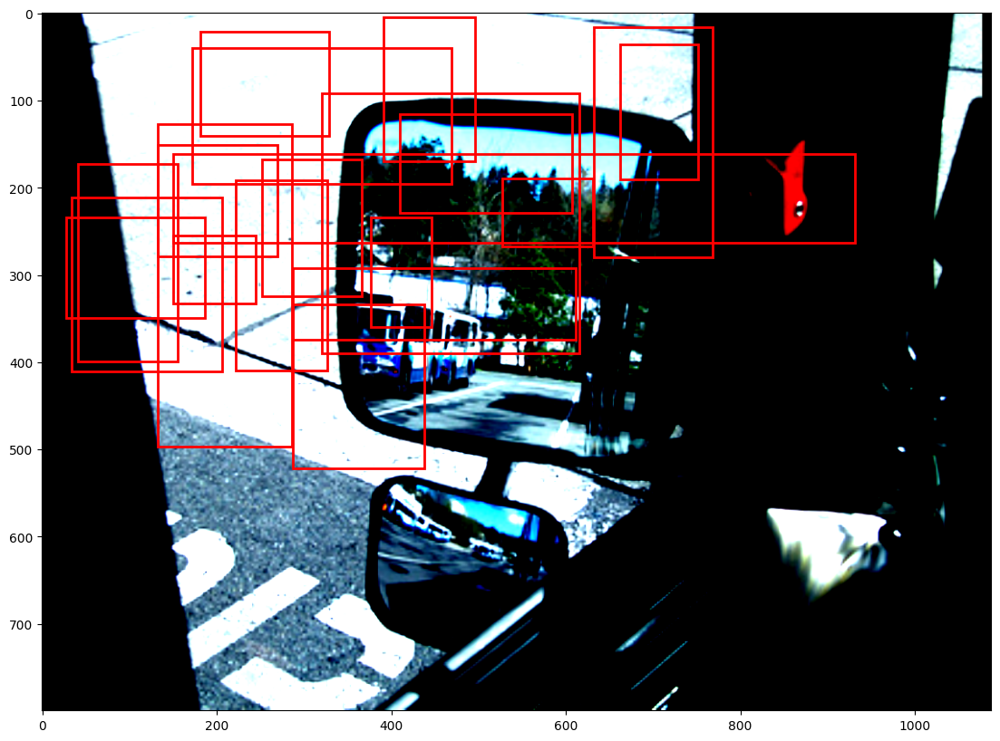

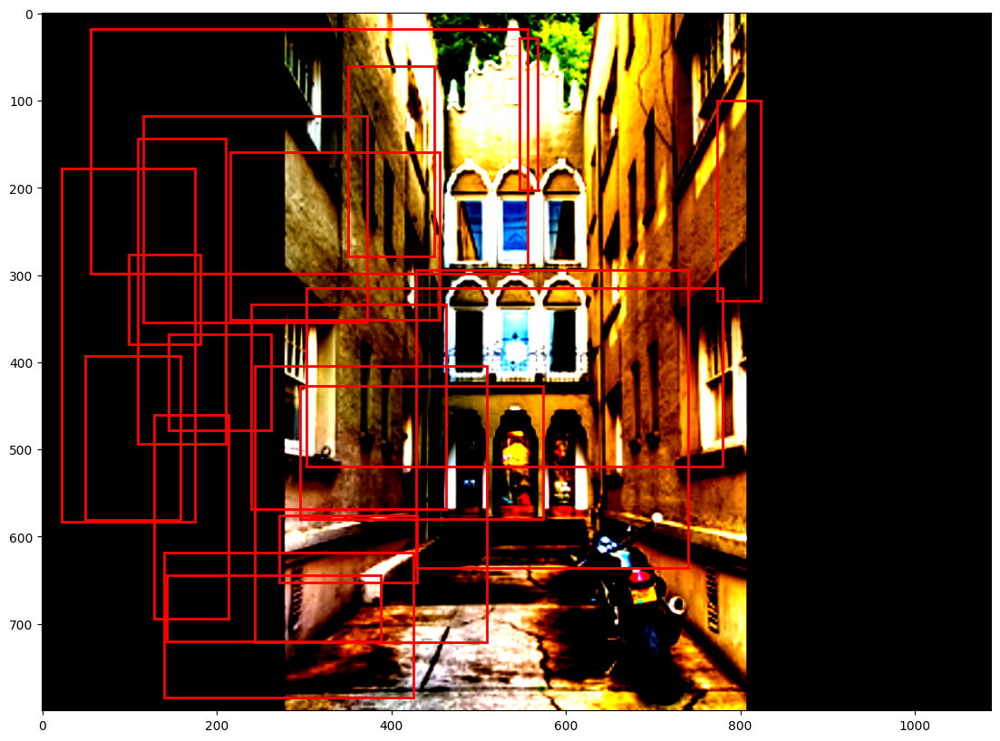

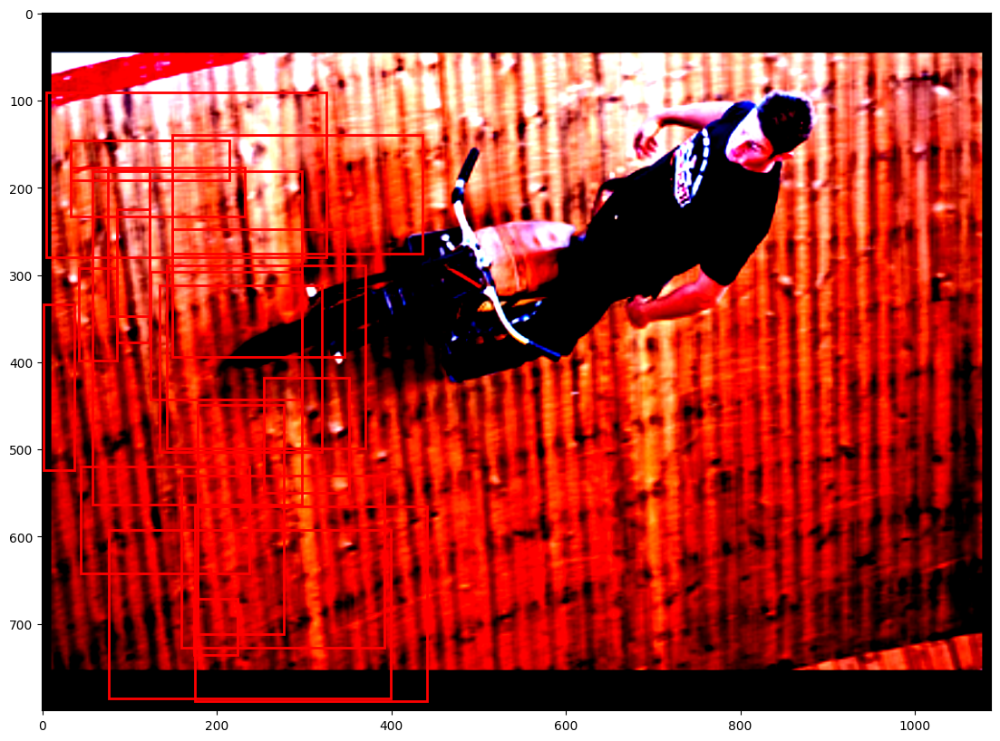

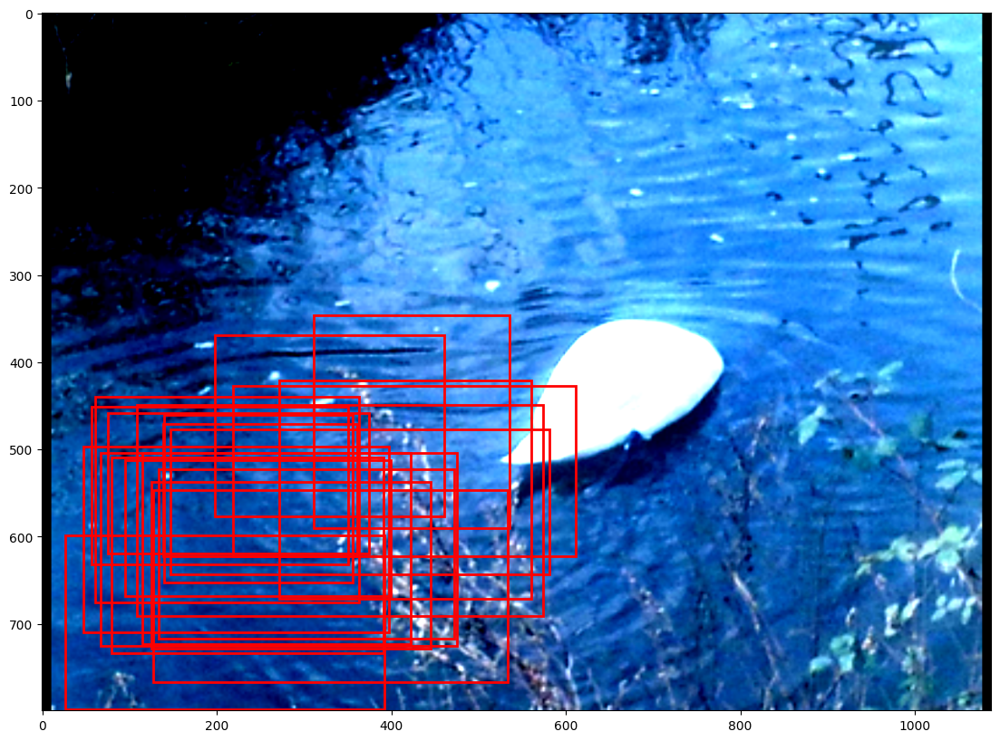

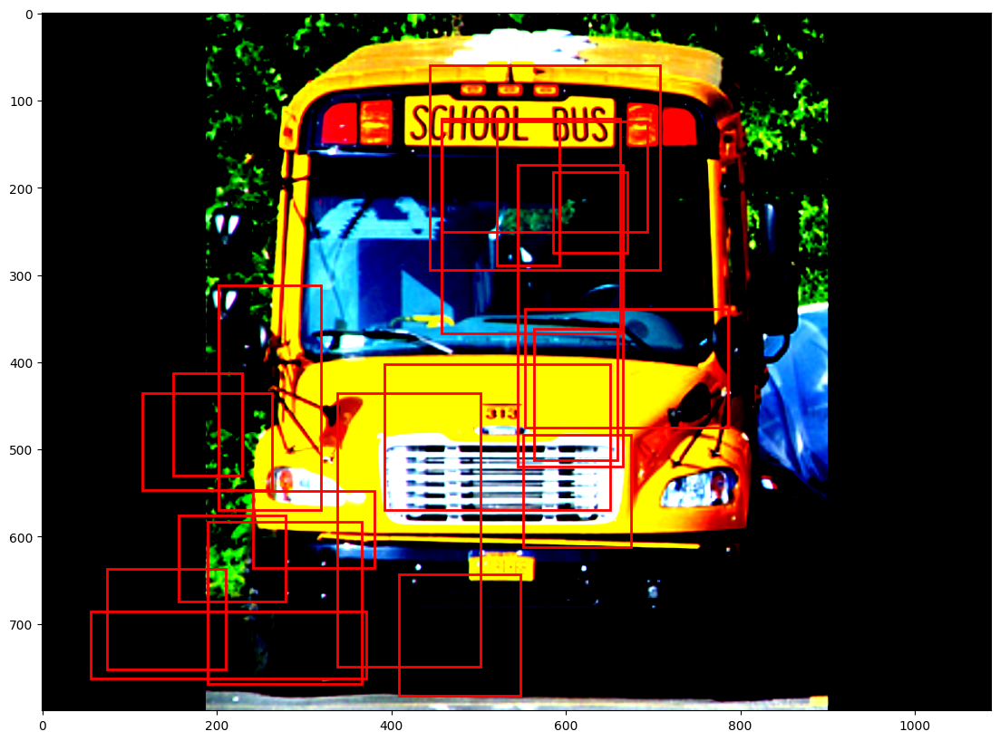

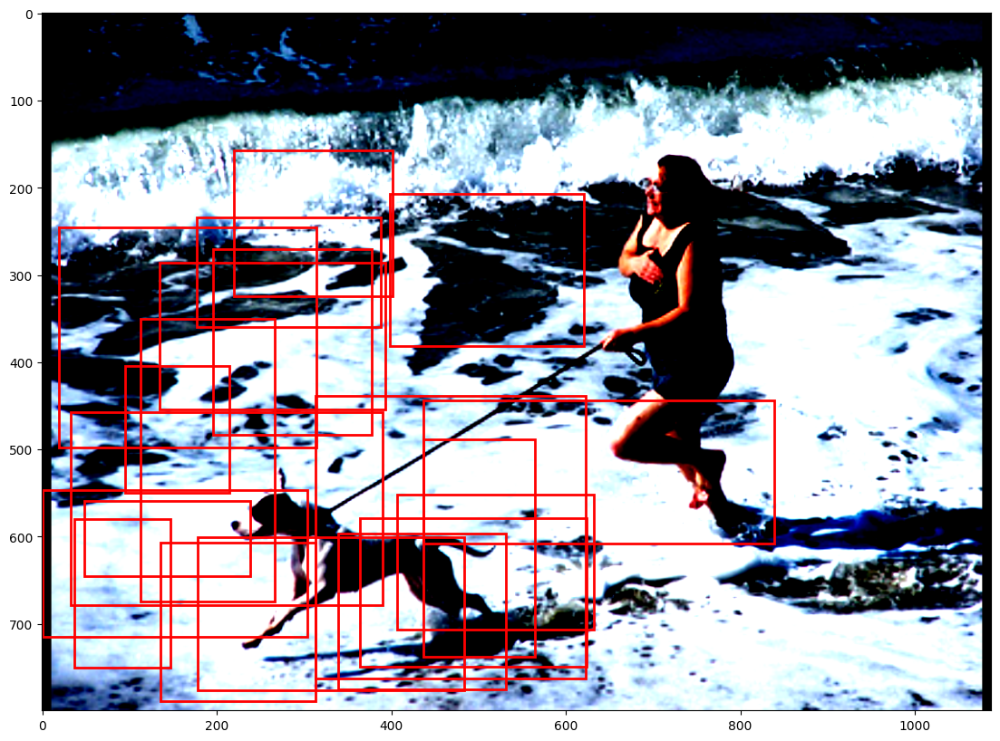

In [15]:
# Reference: gpt for getting the correct shape, and handout instructiuons
#Reference: https://www.geeksforgeeks.org/permutation-and-combination-in-python/


# Enumerate over the test dataset
for i, batch in enumerate(test_loader):
    # Retrieve the images from the batch and stack them
    images = torch.stack(batch['images'])

    # Pass the images through the RPN network to get the logits and bbox regressions
    logits, bbox_regs = rpn_net(images.to(device))

    # Process these outputs to get the scores and bbox before and after NMS
    scores_sorted, pre_nms_matrix, nms_clas, nms_prebox = rpn_net.postprocess(
        logits.detach().cpu(),
        bbox_regs.detach().cpu(),
        IOU_thresh=0.5,
        keep_num_preNMS=20,
        keep_num_postNMS=10
    )

    # Visualize the bounding boxes before NMS
    image_for_plotting = images[0].permute(1, 2, 0).numpy()
    pre_nms_boxes = pre_nms_matrix[0].detach().cpu().numpy()
    plot_bounding_box(image_for_plotting, pre_nms_boxes)
    # plt.title("Top 20 proposals of Test Image {}".format(i + 1))
    plt.show()

    # Stop after the 5th image
    if i == 5:
        break

## Question 6 Visualization of the proposed boxes before and after the NMS [at least 4]. (Section 4.7)

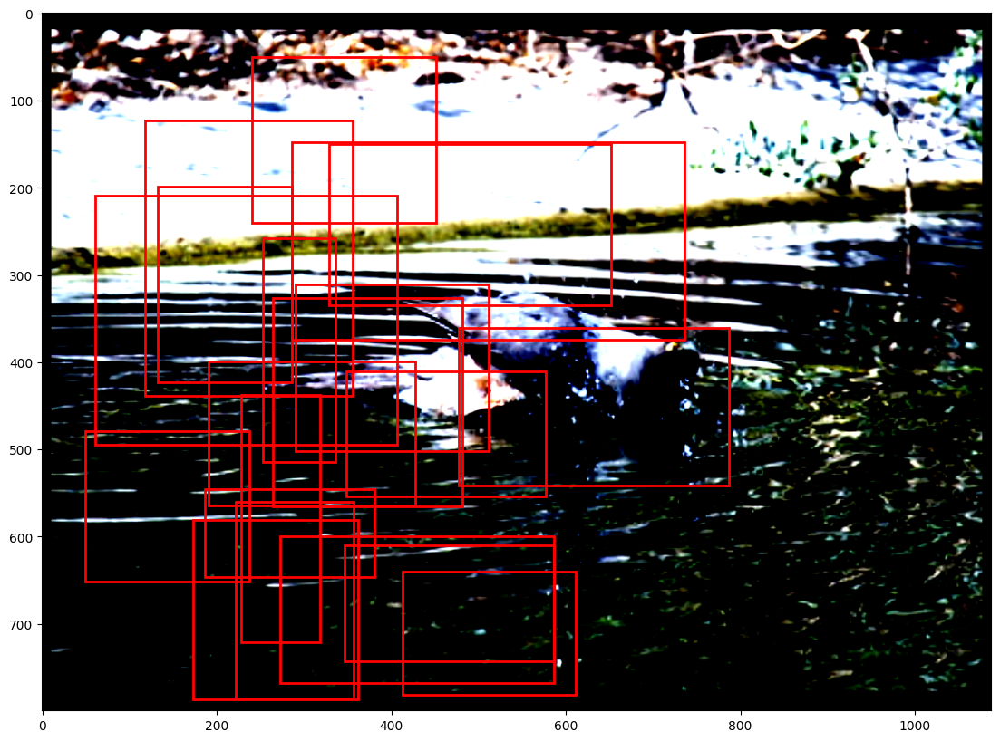

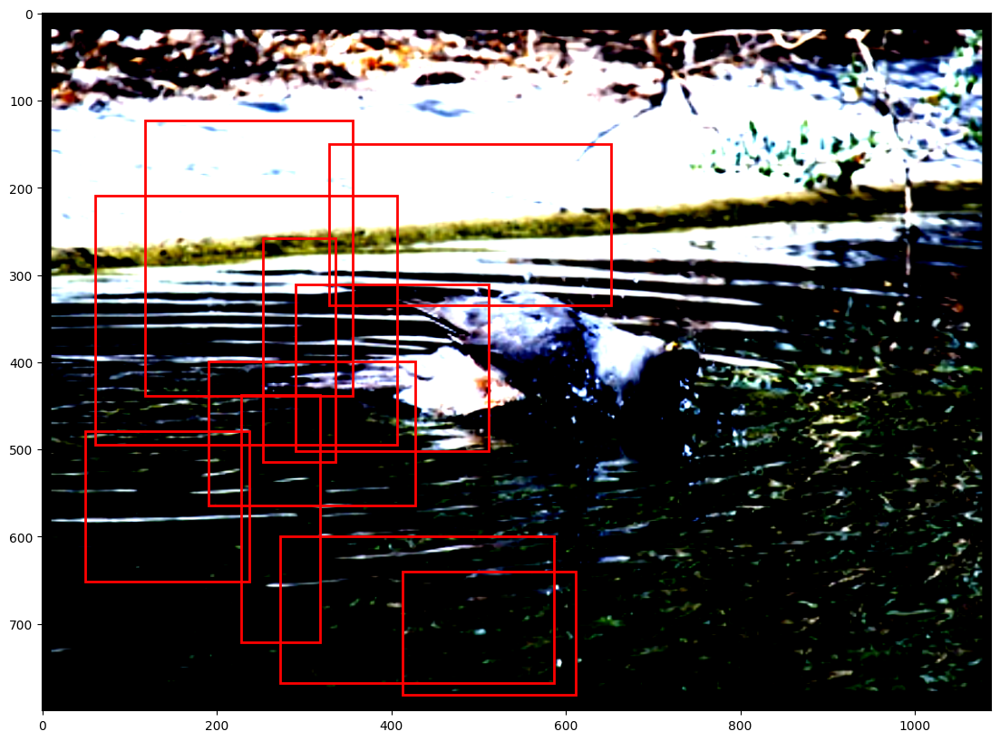

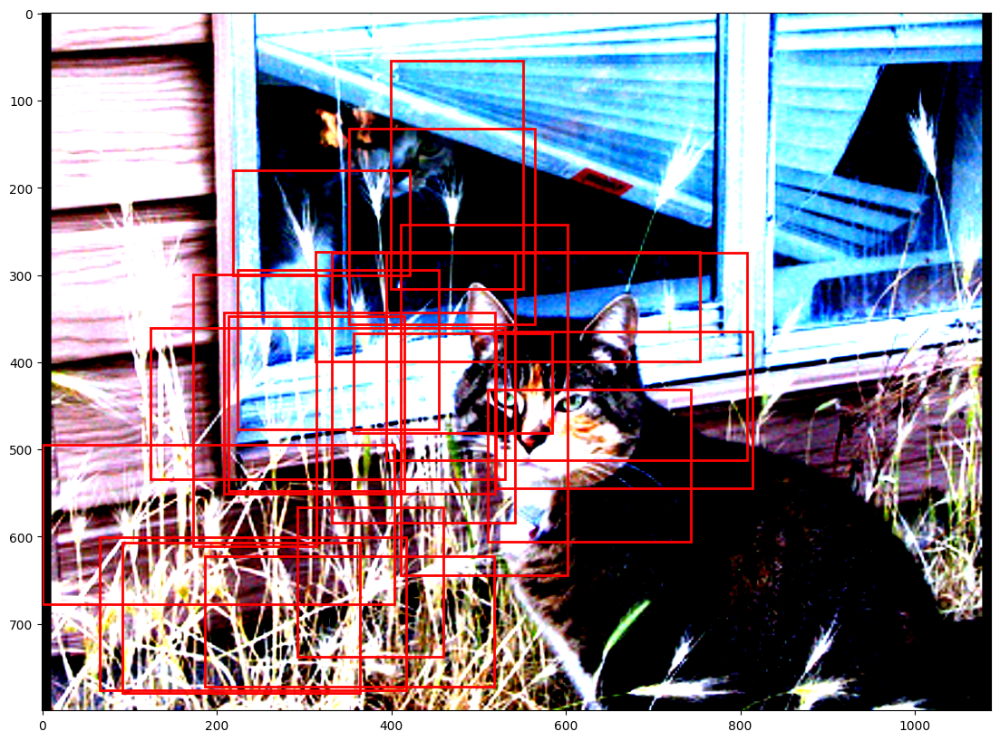

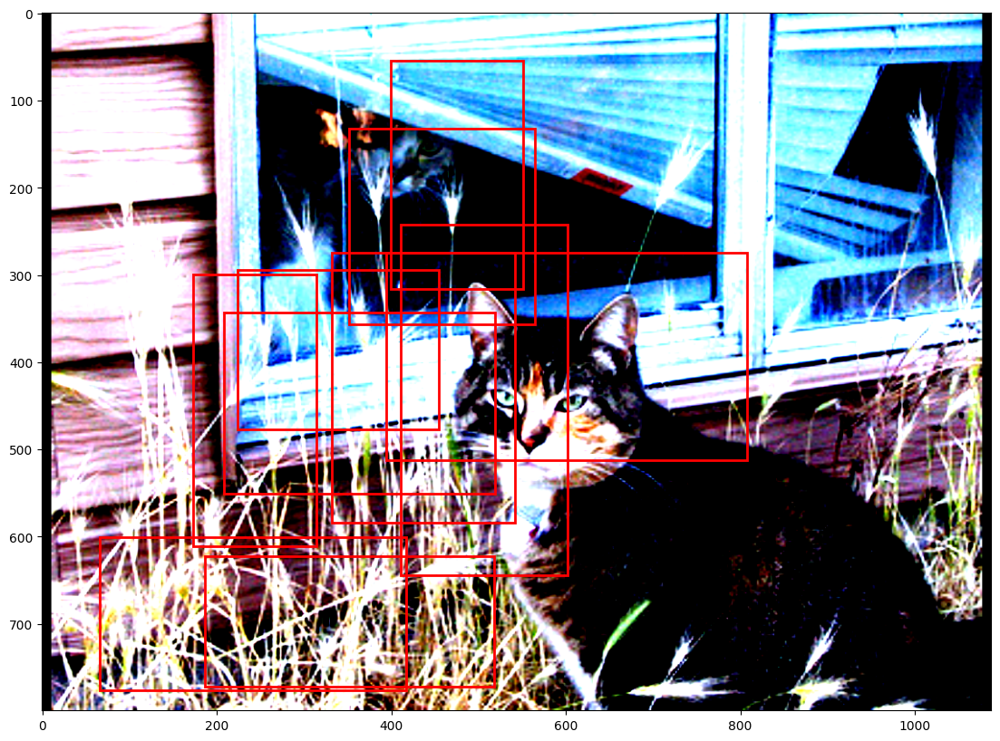

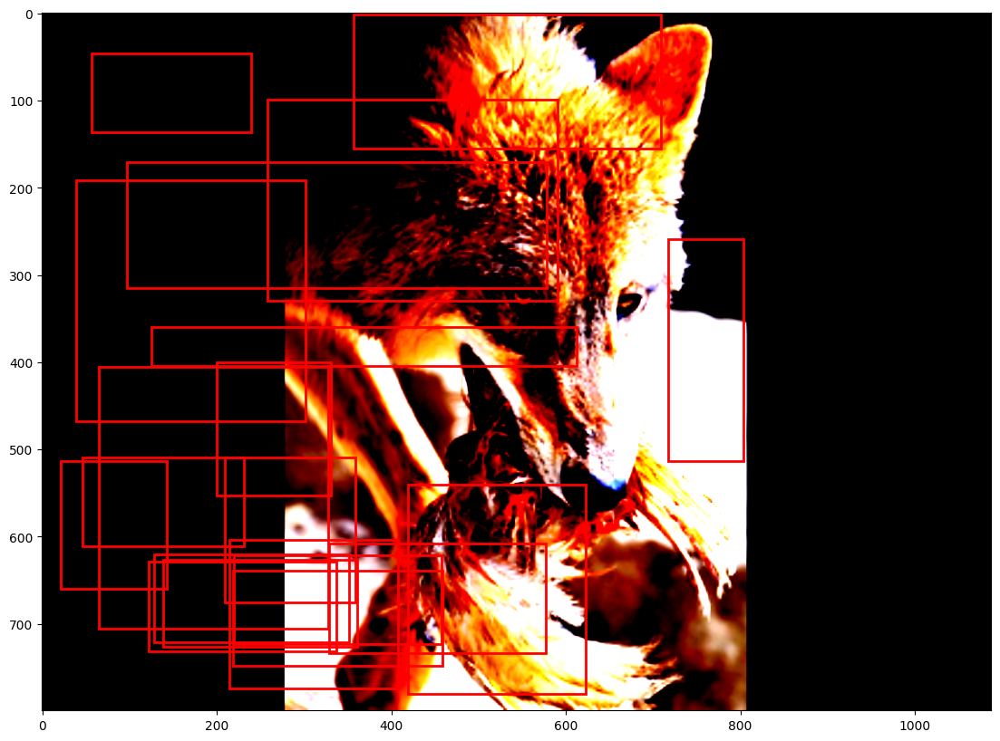

...

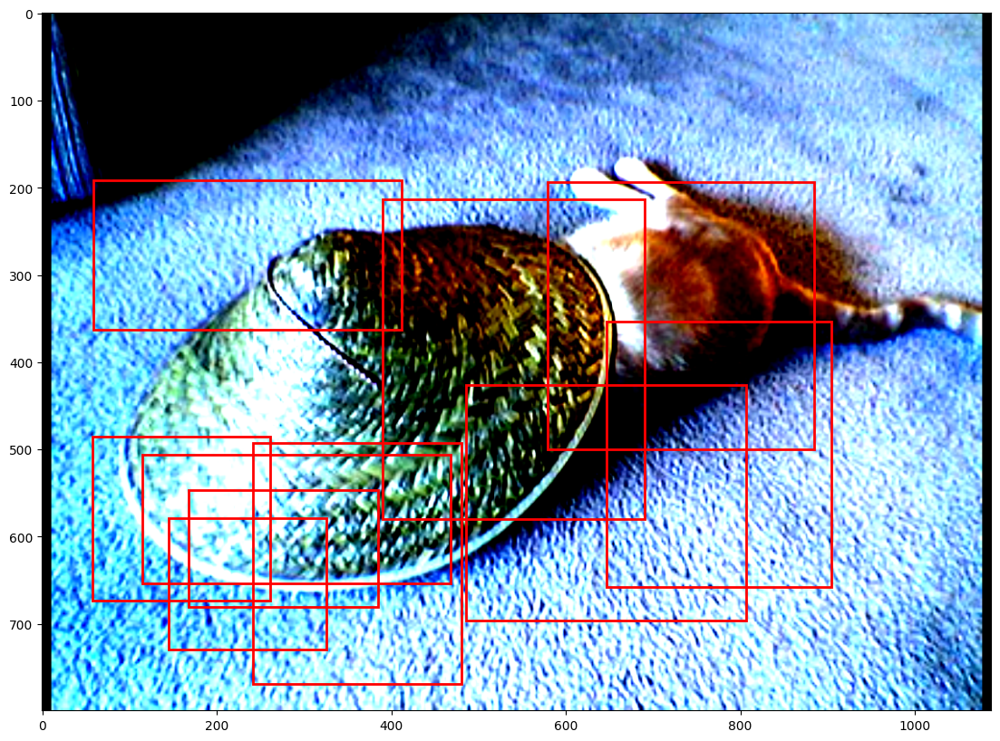

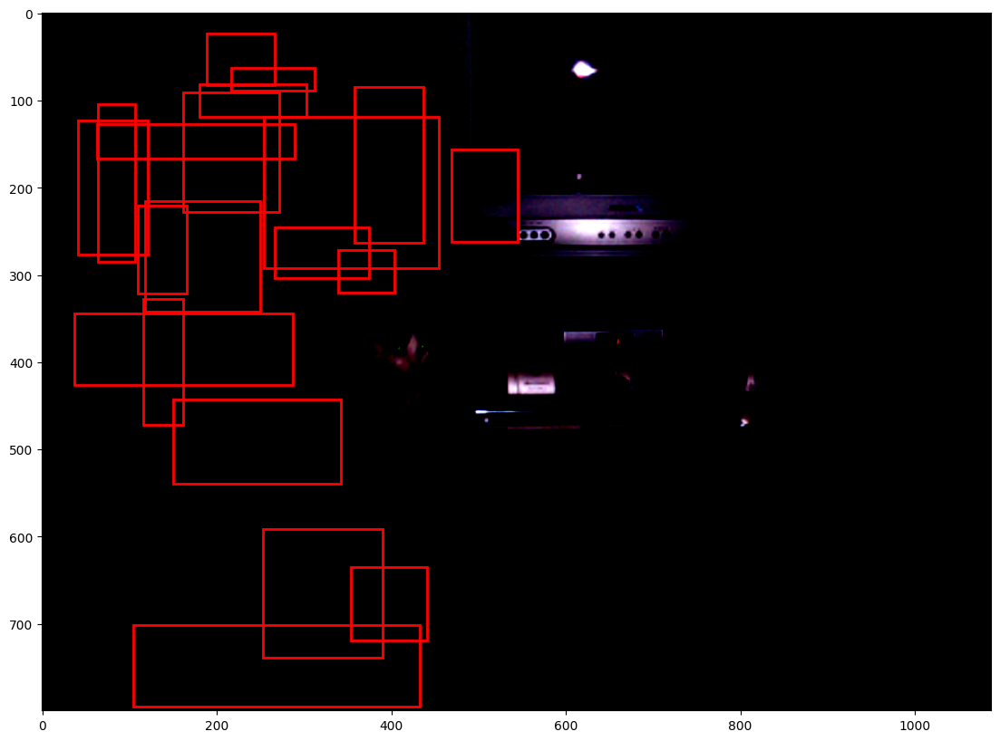

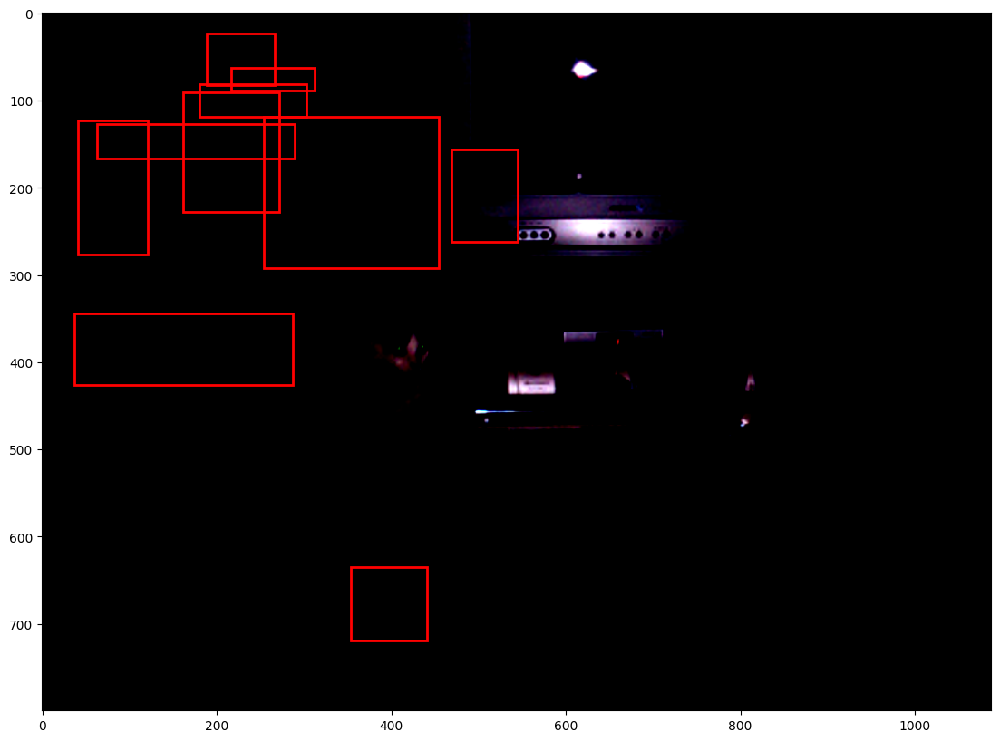

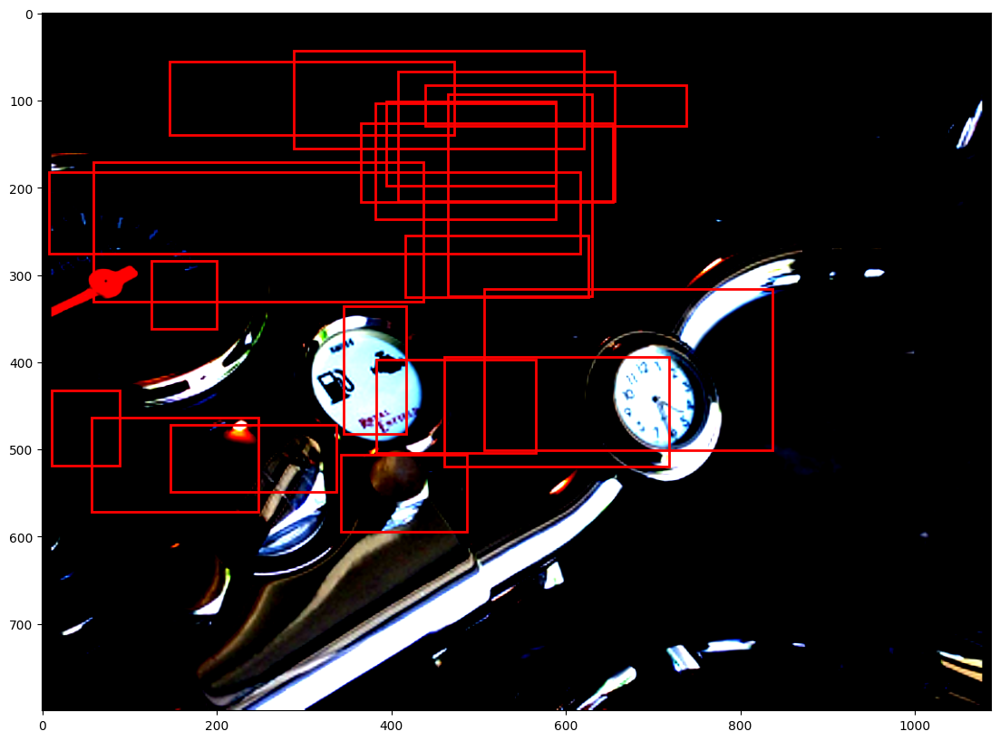

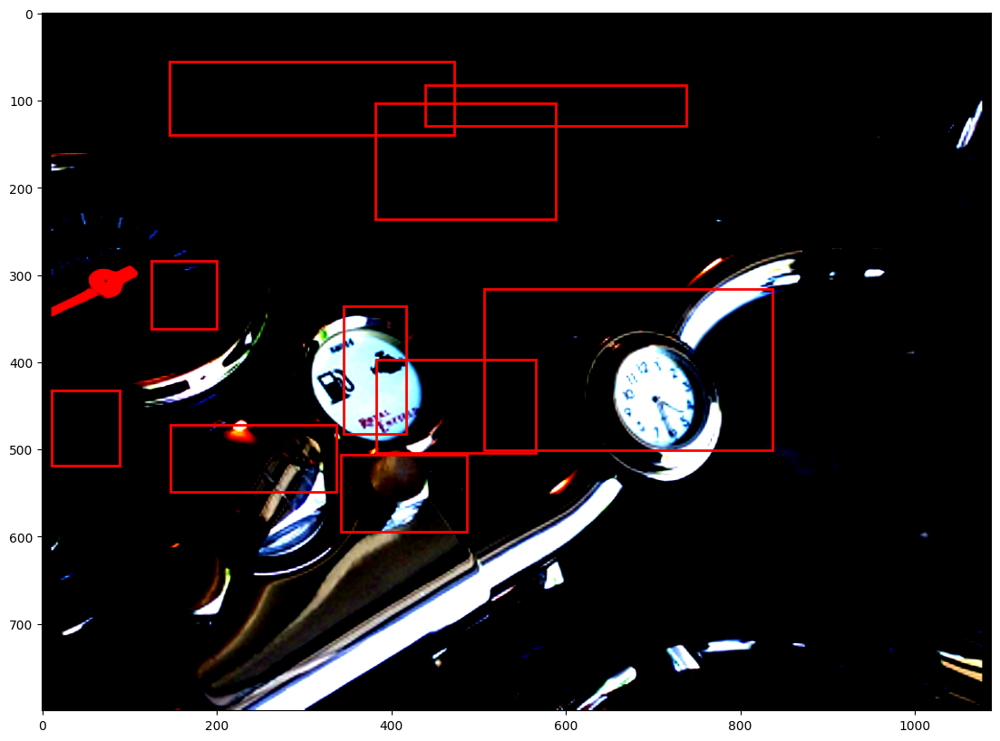

In [16]:
# Reference: gpt for getting the correct shape, ddebugging and handout instructiuons
#Reference: https://www.geeksforgeeks.org/permutation-and-combination-in-python/
# Reference: https://stackoverflow.com/questions/62261793/what-happens-when-we-call-cpu-data-numpy-on-a-pytorch-tensor


for batch_index, data_batch in enumerate(train_loader):
    # Extract image data from the batch
    batch_images = torch.stack(data_batch['images'])

    # Forward pass through the model
    model_logits, bbox_reg_outputs = rpn_net(batch_images.to(device))

    # Process outputs for NMS (Non-Maximum Suppression)
    nms_processed_outputs = rpn_net.postprocess(
        model_logits.detach().cpu(),
        bbox_reg_outputs.detach().cpu(),
        IOU_thresh=0.5,
        keep_num_preNMS=20,
        keep_num_postNMS=10
    )

    # Extract the processed output data
    nms_scores, pre_nms_coords, nms_classifications, nms_bboxes = nms_processed_outputs

    # Visualize bounding boxes before and after NMS
    original_img = batch_images[0].permute(1, 2, 0)
    boxes_pre_nms = pre_nms_coords[0].detach().cpu().numpy()
    boxes_post_nms = nms_bboxes[0].detach().cpu().numpy()

    plot_bounding_box(original_img, boxes_pre_nms)
    plot_bounding_box(original_img, boxes_post_nms)

    # Stop after processing 5 images
    if batch_index == 5:
        break